# Лабораторная Вариант 3 (дедлайн 31.10)
Датасет: Celeba https://www.kaggle.com/datasets/jessicali9530/celeba-dataset
Подготовка датасета: использовать детектор/сегментатор для предварительного вырезания лиц людей.

Можно также добавить технику выравнивания лица (не обязательно).
Обучить VAE или GAN для задачи безусловной генерации лиц.

А затем эту же сетку преобразовать в условную и обучить для задачи условной генерации лиц 
по полу человека (или любому другому признаку).
Метрики: посчитать FID и IS, показать кривые обучения.

! Погуглите и почитайте сами, какие техники и улучшения стоит добавить в VAE/GAN, чтобы они лучше обучились! 
Например, вместо простого GAN лучше посмотреть в сторону WGAN (Вассерштайн ГАН)

In [2]:
pip install -q torchmetrics[image] torch-fidelity

Note: you may need to restart the kernel to use updated packages.


# Imports

In [3]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
from torch.utils.data import Dataset
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import pandas as pd
from PIL import Image, ImageFile
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from tqdm import tqdm
from torchmetrics.image.inception import InceptionScore
from torchmetrics.image.fid import FrechetInceptionDistance
%matplotlib inline

In [177]:
seed = 24

workers = 2

batch_size = 128

image_size = 28

num_epochs = 5

lr = 0.0002

beta1 = 0.5

# Conditional GAN parameter
n_classes = 2

# DCGAN parameters 
nc = 3
nz = 100
ngf = 64
ndf = 64

ngpu = torch.cuda.device_count()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [257]:
img_shape = (nc, image_size, image_size)
img_shape

(3, 28, 28)

In [6]:
def seed_everything(seed: int):
    import random, os
    import numpy as np
    import torch
    
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True
    
seed_everything(seed)

In [7]:
data_dir = '/kaggle/input/celeba-dataset/img_align_celeba/img_align_celeba'

In [8]:
ImageFile.LOAD_TRUNCATED_IMAGES = True

def validate_images(folder_path):
    count_size = {}
    
    file_count = sum(len(files) for _, _, files in os.walk(folder_path))
    print(f"File count {file_count}")
    
    with tqdm(total=file_count) as pbar:
        for root, dirs, files in os.walk(folder_path):
            for file in files:
                pbar.update(1)
                
                if file.lower().endswith(('.jpg', '.jpeg', '.png')):    
                    image_path = os.path.join(root, file)
                
                    try:
                        img = Image.open(image_path)
                        
                        count_size[img.size] = count_size.get(img.size, 0) + 1
                        
                        img.load()
                        img.close()
                    except Exception as e:
                        print(f"Image is incorrect: {image_path}")
                        print(e)
                        os.remove(image_path)
    return count_size

In [15]:
validate_images(data_dir)

File count 202599


100%|██████████| 202599/202599 [24:03<00:00, 140.34it/s]


{(178, 218): 202599}

In [9]:
class CelebaDataset(Dataset):
    """Custom Dataset for loading CelebA face images"""

    def __init__(self, csv_path, img_dir, transform=None):
        df = pd.read_csv(csv_path)
        df.loc[df['Male'] == -1, 'Male'] = 0
        self.y = df['Male'].values
        self.img_names = df['image_id'].values
        
        self.img_dir = img_dir
        
        self.transform = transform

    def __getitem__(self, index):
        img = Image.open(os.path.join(self.img_dir,
                                      self.img_names[index]))
        
        if self.transform is not None:
            img = self.transform(img)
        
        label = self.y[index]
        return img, label

    def __len__(self):
        return self.y.shape[0]

In [178]:
transform_img = transforms.Compose([
    transforms.Resize(image_size),  
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

In [179]:
dataset = CelebaDataset(csv_path='/kaggle/input/celeba-dataset/list_attr_celeba.csv',
                        img_dir=data_dir,
                        transform=transform_img)

# dataset = torch.utils.data.Subset(dataset, torch.arange(3000))

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

print(len(dataloader.dataset))

202599


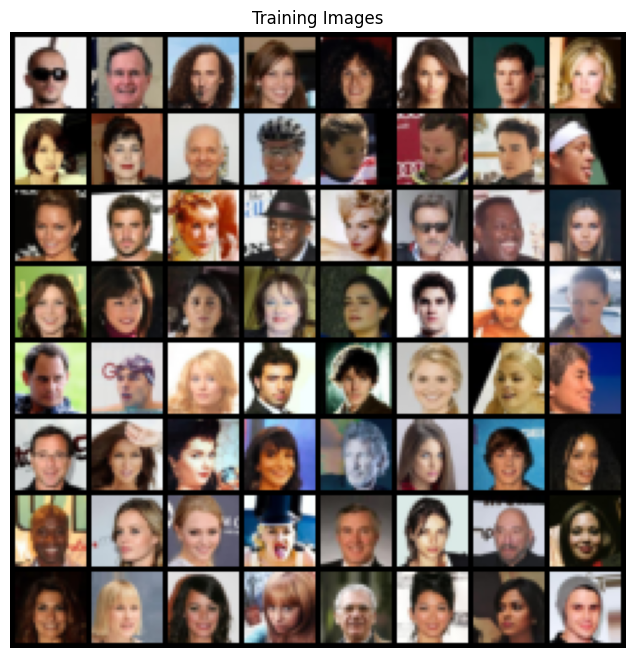

In [180]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(
    vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

# GAN implementation

In [13]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# DCGAN

In [14]:
class DCGAN_Generator(nn.Module):
    def __init__(self):
        super(DCGAN_Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [23]:
class DCGAN_Discriminator(nn.Module):
    def __init__(self):
        super(DCGAN_Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

# Linear GAN

In [24]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        def block(in_feat, out_feat, normalize=True):
            layers = [nn.Linear(in_feat, out_feat)]
            if normalize:
                layers.append(nn.BatchNorm1d(out_feat, 0.8))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *block(nz, 128, normalize=False),
            *block(128, 256),
            *block(256, 512),
            *block(512, 1024),
            nn.Linear(1024, int(np.prod(img_shape))),
            nn.Tanh() # output pixel image in range [-1, 1]
        )

    def forward(self, z):
        img = self.model(z)
        img = img.view(img.size(0), *img_shape)
        return img

In [25]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.model = nn.Sequential(
            nn.Linear(int(np.prod(img_shape)), 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
            nn.Sigmoid(),
        )

    def forward(self, img):
        img_flat = img.view(img.size(0), -1)
        validity = self.model(img_flat)

        return validity

# Initialization

In [46]:
netG = DCGAN_Generator().to(device)

if (device.type == 'cuda') and (ngpu > 1):
    print(f"{ngpu} device count")
    netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)

print(netG)

2 device count
DataParallel(
  (module): DCGAN_Generator(
    (main): Sequential(
      (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
      (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): ReLU(inplace=True)
      (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): ReLU(inplace=True)
      (12): ConvTranspose2d(64, 3, kernel_size

In [47]:
netD = DCGAN_Discriminator().to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)

print(netD)

DataParallel(
  (module): DCGAN_Discriminator(
    (main): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
      (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (4): LeakyReLU(negative_slope=0.2, inplace=True)
      (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (7): LeakyReLU(negative_slope=0.2, inplace=True)
      (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (10): LeakyReLU(negative_slope=0.2, inplace=True)
      (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False

In [48]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device) # TODO: change z shape

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [49]:
fid_metric = FrechetInceptionDistance().to(device)
inception_metric = InceptionScore().to(device)

In [59]:
def train_discriminator(D_model, G_model, data):
    images = data[0].to(device)
    b_size = images.size(0)
    
    valid = torch.ones(b_size, device=device)
    fake = torch.zeros(b_size, device=device)
    
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    
    D_model.zero_grad()
    
    ## Train with all-real batch
    output = D_model(images).view(-1)

    errD_real = criterion(output, valid)
    errD_real.backward()
    
    D_x = output.mean().item()

    ## Train with all-fake batch
    fake_images = G_model(noise)

    output = D_model(fake_images.detach()).view(-1)

    errD_fake = criterion(output, fake)
    errD_fake.backward()
    
    D_G_z1 = output.mean().item()

    errD = errD_real + errD_fake

    optimizerD.step()
    
    return errD, D_x, D_G_z1

In [60]:
def train_generator(G_model, D_model, data):
    b_size = data[0].size(0)
    
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake = torch.ones(b_size, device=device)
    
    G_model.zero_grad()

    fake_images = G_model(noise)
    output = D_model(fake_images).view(-1)

    errG = criterion(output, fake)
    
    D_G_z2 = output.mean().item()

    errG.backward()

    optimizerG.step()
    
    return errG, D_G_z2

In [61]:
img_list = []
G_losses = []
D_losses = []
real_scores = []
fake_scores = []
FIDs = []
ISs = []
iters = 0

Starting Training Loop...


0it [00:00, ?it/s]/opt/conda/lib/python3.10/site-packages/torch/nn/parallel/parallel_apply.py:79: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.device(device), torch.cuda.stream(stream), autocast(enabled=autocast_enabled):
0it [00:04, ?it/s, Epoch=1/5, Step=1/1583, D_Loss=0.3539, G_Loss=5.8312, D(x)=0.9750, D(G(z))=0.2412/0.0062]

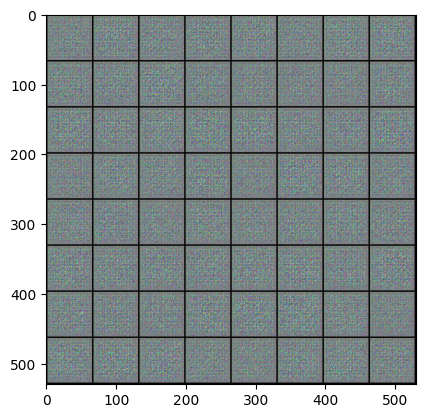

10it [00:43,  3.38s/it, Epoch=1/5, Step=1/1583, D_Loss=0.3539, G_Loss=5.8312, D(x)=0.9750, D(G(z))=0.2412/0.0062]

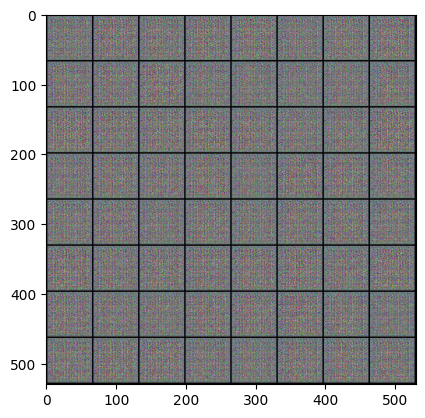

20it [01:19,  3.25s/it, Epoch=1/5, Step=1/1583, D_Loss=0.3539, G_Loss=5.8312, D(x)=0.9750, D(G(z))=0.2412/0.0062]

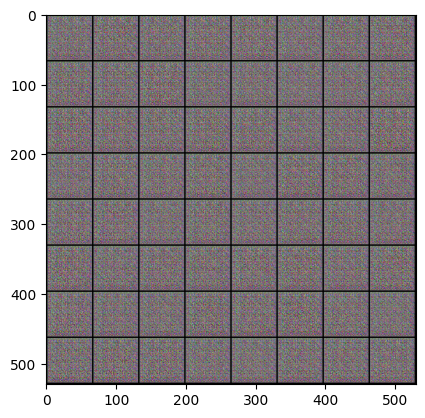

30it [01:54,  3.25s/it, Epoch=1/5, Step=1/1583, D_Loss=0.3539, G_Loss=5.8312, D(x)=0.9750, D(G(z))=0.2412/0.0062]

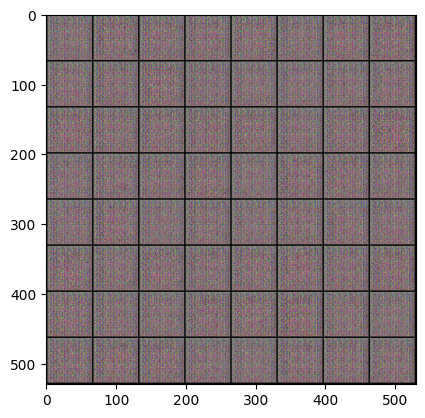

40it [02:30,  3.25s/it, Epoch=1/5, Step=1/1583, D_Loss=0.3539, G_Loss=5.8312, D(x)=0.9750, D(G(z))=0.2412/0.0062]

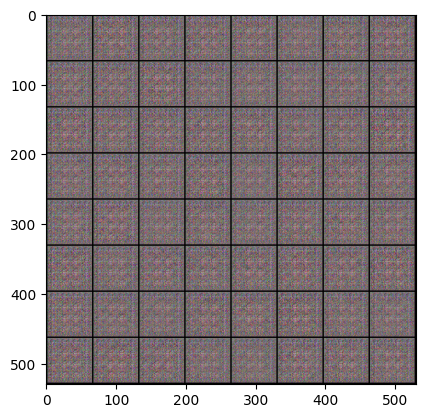

50it [03:09,  3.25s/it, Epoch=1/5, Step=51/1583, D_Loss=1.6972, G_Loss=21.0213, D(x)=0.9704, D(G(z))=0.6603/0.0000]

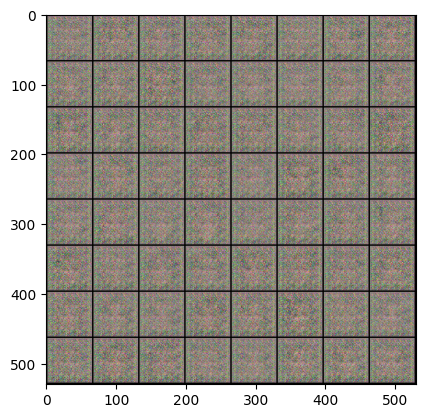

60it [03:42,  3.25s/it, Epoch=1/5, Step=51/1583, D_Loss=1.6972, G_Loss=21.0213, D(x)=0.9704, D(G(z))=0.6603/0.0000]

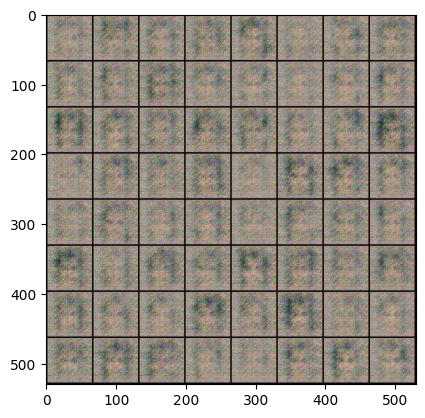

70it [04:17,  3.25s/it, Epoch=1/5, Step=51/1583, D_Loss=1.6972, G_Loss=21.0213, D(x)=0.9704, D(G(z))=0.6603/0.0000]

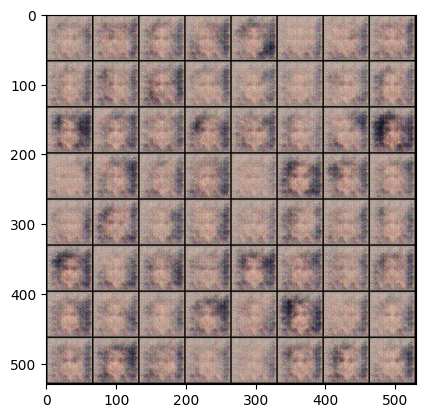

80it [04:53,  3.24s/it, Epoch=1/5, Step=51/1583, D_Loss=1.6972, G_Loss=21.0213, D(x)=0.9704, D(G(z))=0.6603/0.0000]

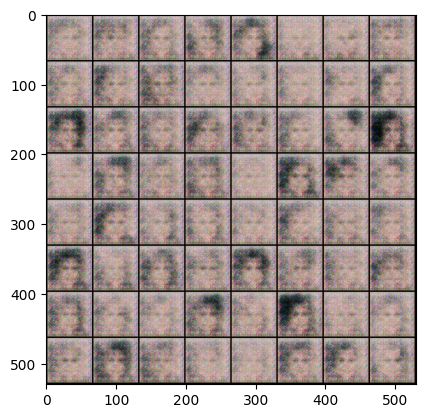

90it [05:29,  3.25s/it, Epoch=1/5, Step=51/1583, D_Loss=1.6972, G_Loss=21.0213, D(x)=0.9704, D(G(z))=0.6603/0.0000]

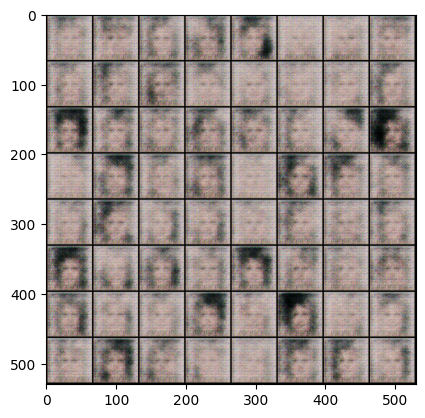

100it [06:08,  3.24s/it, Epoch=1/5, Step=101/1583, D_Loss=0.2761, G_Loss=7.3672, D(x)=0.9469, D(G(z))=0.1740/0.0018]

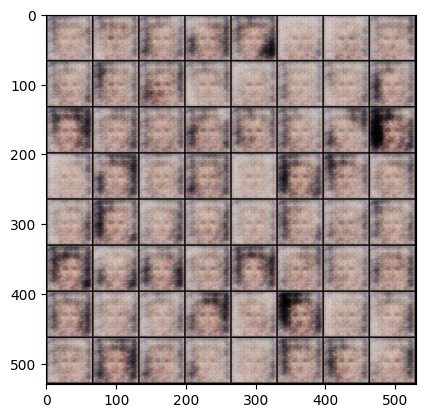

110it [06:40,  3.25s/it, Epoch=1/5, Step=101/1583, D_Loss=0.2761, G_Loss=7.3672, D(x)=0.9469, D(G(z))=0.1740/0.0018]

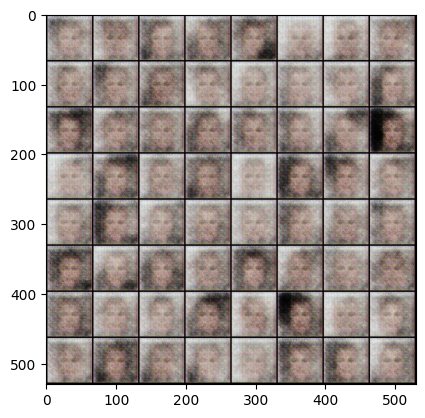

113it [06:55,  3.68s/it, Epoch=1/5, Step=101/1583, D_Loss=0.2761, G_Loss=7.3672, D(x)=0.9469, D(G(z))=0.1740/0.0018]


KeyboardInterrupt: 

In [62]:
print("Starting Training Loop...")
for epoch in range(num_epochs):
    cur_tqdm = tqdm(enumerate(dataloader, 0))
    for i, data in cur_tqdm:
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        errD, D_x, D_G_z1 = train_discriminator(netD, netG, data)

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        errG, D_G_z2 = train_generator(netG, netD, data)
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        real_scores.append(D_x)
        fake_scores.append(D_G_z1)

        if i % 50 == 0:
            show_dict = {'Epoch': f'{epoch + 1}/{num_epochs}',
                         'Step': f'{i + 1}/{len(dataloader)}',
                         'D_Loss': f'{errD.item():.4f}',
                         'G_Loss': f'{errG.item():.4f}',
                         'D(x)': f'{D_x:.4f}',
                         'D(G(z))': f'{D_G_z1:.4f}/{D_G_z2:.4f}'}
            
            cur_tqdm.set_postfix(show_dict)
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            
            noise = torch.randn(data[0].size(0), nz, 1, 1, device=device)

            with torch.no_grad():
                generated_images = netG(noise).to(torch.uint8)
                
            fid_metric.update(real_cpu.to(torch.uint8), real=True)
            fid_metric.update(generated_images, real=False)
            inception_metric.update(generated_images)
            
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()

            fake_grid = vutils.make_grid(fake, padding=2, normalize=True)
            
            plt.imshow(np.transpose(fake_grid, (1,2,0)))
            plt.show()
            
            img_list.append(fake_grid)

        iters += 1
    
    fid_val = fid_metric.compute()
    inc_val = inception_metric.compute()

    FIDs.append(fid_val.item())
    ISs.append([inc_val[0].item(), inc_val[1].item()])

    print(f"FID: {FIDs[-1]}\tIS: {ISs[-1]}")

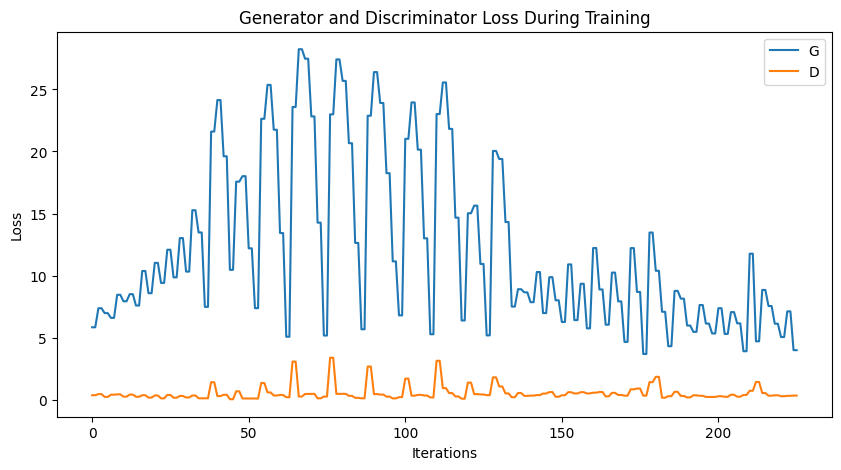

In [63]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

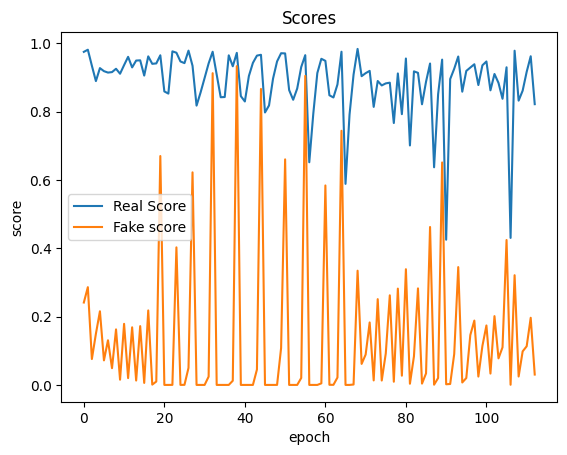

In [64]:
plt.plot(real_scores, "-")
plt.plot(fake_scores, "-")
plt.xlabel("epoch")
plt.ylabel("score")
plt.legend(["Real Score", "Fake score"])
plt.title("Scores")
plt.show()

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

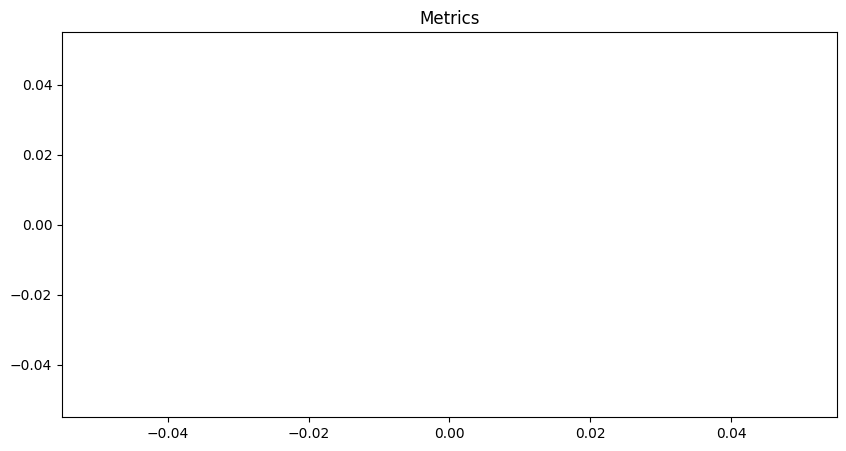

In [65]:
plt.figure(figsize=(10,5))
plt.title("Metrics")
plt.plot(FIDs, label="FID")
plt.plot(np.array(ISs)[:, 0], label="IS")
plt.xlabel("Epochs")
plt.legend()
plt.show()

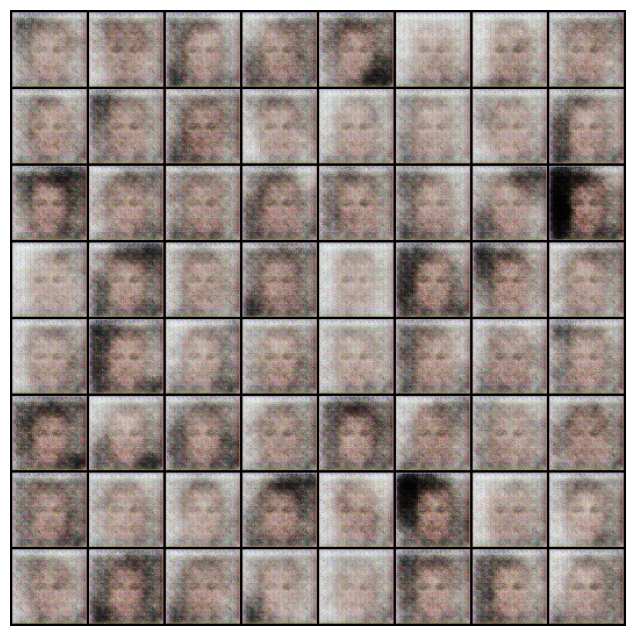

In [66]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

In [68]:
torch.save({
            'epoch': epoch,
            'model_state_dict': netG.state_dict(),
            'optimizer_state_dict': optimizerG.state_dict(),
            }, 'gan-g-1.pth')

In [69]:
torch.save({
            'epoch': epoch,
            'model_state_dict': netD.state_dict(),
            'optimizer_state_dict': optimizerD.state_dict(),
            }, 'gan-d-1.pth')

# Conditional GAN

In [67]:
class CGenerator(nn.Module):
    def __init__(self):
        super(CGenerator, self).__init__()

        self.label_emb = nn.Embedding(n_classes, n_classes)

        def block(in_feat, out_feat, normalize=True):
            layers = [nn.Linear(in_feat, out_feat)]
            if normalize:
                layers.append(nn.BatchNorm1d(out_feat, 0.8))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *block(nz + n_classes, 128, normalize=False),
            *block(128, 256),
            *block(256, 512),
            *block(512, 1024),
            nn.Linear(1024, int(np.prod(img_shape))),
            nn.Tanh()
        )

    def forward(self, noise, labels):
        # Concatenate label embedding and image to produce input
        gen_input = torch.cat((self.label_emb(labels), noise), -1)
        img = self.model(gen_input)
        img = img.view(img.size(0), *img_shape)
        return img

In [68]:
class CDiscriminator(nn.Module):
    def __init__(self):
        super(CDiscriminator, self).__init__()

        self.label_embedding = nn.Embedding(n_classes, n_classes)

        self.model = nn.Sequential(
            nn.Linear(n_classes + int(np.prod(img_shape)), 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 512),
            nn.Dropout(0.4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 1),
            nn.Sigmoid()
        )

    def forward(self, img, labels):
        # Concatenate label embedding and image to produce input
        d_in = torch.cat((img.view(img.size(0), -1), self.label_embedding(labels)), -1)
        validity = self.model(d_in)
        return validity

# Conditional DCGAN

In [234]:
class CDCGAN_Discriminator(nn.Module):
    def __init__(self):
        super(CDCGAN_Discriminator, self).__init__()
    
        # creating layer for image input , input size : (batch_size, 3, 28, 28)
        self.layer_x = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            # out size : (batch_size, 32, 14, 14)
            nn.LeakyReLU(0.2, inplace=True),
            # out size : (batch_size, 32, 14, 14)
        )

        # creating layer for label input, input size : (batch_size, 10, 28, 28)
        self.layer_y = nn.Sequential(
            nn.Conv2d(in_channels=2, out_channels=32, kernel_size=4, stride=2, padding=1, bias=False),
            # out size : (batch_size, 32, 14, 14)
            nn.LeakyReLU(0.2, inplace=True),
            # out size : (batch_size, 32, 14, 14)
        )

        # layer for concat of image layer and label layer, input size : (batch_size, 64, 14, 14)
        self.layer_xy = nn.Sequential(
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
            # out size : (batch_size, 128, 7, 7)
            nn.BatchNorm2d(128),
            # out size : (batch_size, 128, 7, 7)
            nn.LeakyReLU(0.2, inplace=True),
            # out size : (batch_size, 128, 7, 7)

            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, stride=2, padding=0, bias=False),
            # out size : (batch_size, 256, 3, 3)
            nn.BatchNorm2d(256),
            # out size : (batch_size, 256, 3, 3)
            nn.LeakyReLU(0.2, inplace=True),
            # out size : (batch_size, 256, 3, 3)

            # Notice in below layer, we are using out channels as 1, we don't need to use Linear layer
            # Same is recommended in DCGAN paper also
            nn.Conv2d(in_channels=256, out_channels=1, kernel_size=3, stride=1, padding=0, bias=False),
            # out size : (batch_size, 1, 1, 1)

            # sigmoid layer to convert in [0,1] range
            nn.Sigmoid()
        )
  
    def forward(self, x, y):
        # size of x : (batch_size, 3, 28, 28)
        x = self.layer_x(x)
        # size of x : (batch_size, 32, 14, 14)

        # size of y : (batch_size, 10, 28, 28)
        y = self.layer_y(y)
        # size of y : (batch_size, 32, 14, 14)

        # concat image layer and label layer output
        xy = torch.cat([x,y], dim=1)
        # size of xy : (batch_size, 64, 14, 14)
        xy = self.layer_xy(xy)
        # size of xy : (batch_size, 1, 1, 1)
        xy = xy.view(xy.shape[0], -1)
        # size of xy : (batch_size, 1)

        return xy

In [236]:
class CDCGAN_Generator(nn.Module):
    def __init__(self, input_size=100):
        # initalize super module
        super(CDCGAN_Generator, self).__init__()

        # noise z input layer : (batch_size, 100, 1, 1)
        self.layer_x = nn.Sequential(
            nn.ConvTranspose2d(in_channels=100, out_channels=128, kernel_size=3, stride=1, padding=0, bias=False),
            # out size : (batch_size, 128, 3, 3)
            nn.BatchNorm2d(128),
            # out size : (batch_size, 128, 3, 3)
            nn.ReLU(),
            # out size : (batch_size, 128, 3, 3)
        )

        # label input layer : (batch_size, 10, 1, 1)
        self.layer_y = nn.Sequential(
            nn.ConvTranspose2d(in_channels=2, out_channels=128, kernel_size=3, stride=1, padding=0, bias=False),
            # out size : (batch_size, 128, 3, 3)
            nn.BatchNorm2d(128),
            # out size : (batch_size, 128, 3, 3)
            nn.ReLU(),
            # out size : (batch_size, 128, 3, 3)
        )

        # noise z and label concat input layer : (batch_size, 256, 3, 3)
        self.layer_xy = nn.Sequential(
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=3, stride=2, padding=0, bias=False),
            # out size : (batch_size, 128, 7, 7)
            nn.BatchNorm2d(128),
            # out size : (batch_size, 128, 7, 7)
            nn.ReLU(),
            # out size : (batch_size, 128, 7, 7)

            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
            # out size : (batch_size, 64, 14, 14)
            nn.BatchNorm2d(64),
            # out size : (batch_size, 64, 14, 14)
            nn.ReLU(),
            # out size : (batch_size, 64, 14, 14)

            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            # out size : (batch_size, 1, 28, 28)
            nn.Tanh()
        )
        # out size : (batch_size, 1, 28, 28)
    
    def forward(self, x, y):
        # x size : (batch_size, 100)
        x = x.view(x.shape[0], x.shape[1], 1, 1)
        # x size : (batch_size, 100, 1, 1)
        x = self.layer_x(x)
        # x size : (batch_size, 128, 3, 3)

        # y size : (batch_size, 10)
        y = y.view(y.shape[0], y.shape[1], 1, 1)
        # y size : (batch_size, 100, 1, 1)
        y = self.layer_y(y)
        # y size : (batch_size, 128, 3, 3)

        # concat x and y 
        xy = torch.cat([x, y], dim=1)
        # xy size : (batch_size, 256, 3, 3)
        xy = self.layer_xy(xy)
        # xy size : (batch_size, 3, 28, 28)
        return xy

In [237]:
netCG = CDCGAN_Generator().to(device)

if (device.type == 'cuda') and (ngpu > 1):
    print(f"{ngpu} device count")
    netCG = nn.DataParallel(netCG, list(range(ngpu)))

netCG.apply(weights_init)

print(netCG)

2 device count
DataParallel(
  (module): CDCGAN_Generator(
    (layer_x): Sequential(
      (0): ConvTranspose2d(100, 128, kernel_size=(3, 3), stride=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (layer_y): Sequential(
      (0): ConvTranspose2d(2, 128, kernel_size=(3, 3), stride=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (layer_xy): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(3, 3), stride=(2, 2), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU()
      (6): ConvTranspose2d(64, 3, kernel_size=(4, 4), strid

In [238]:
netCD = CDCGAN_Discriminator().to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netCD = nn.DataParallel(netCD, list(range(ngpu)))

netCD.apply(weights_init)

print(netCD)

DataParallel(
  (module): CDCGAN_Discriminator(
    (layer_x): Sequential(
      (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (layer_y): Sequential(
      (0): Conv2d(2, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (layer_xy): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
      (3): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), bias=False)
      (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace=True)
      (6): Conv2d(256, 1, kernel_size=(3, 3), stride=(1, 1), bias=False)
      (7): Sigmoid()
    )
  )
)


In [239]:
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, nz, device=device)
fixed_labels = torch.randint(0, n_classes, (64,))

optimizerCD = optim.Adam(netCD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerCG = optim.Adam(netCG.parameters(), lr=lr, betas=(beta1, 0.999))

In [240]:
img_list = []
G_losses = []
D_losses = []
real_scores = []
fake_scores = []
FIDs = []
ISs = []
iters = 0

In [241]:
class_labels = torch.tensor([0, 1]).view(n_classes, 1)

# convert labels to onehot encoding
onehot = torch.zeros(n_classes, n_classes).scatter_(1, class_labels, 1)

# reshape labels to image size, with number of labels as channel
# first dim is a batch_size
fill = torch.zeros([n_classes, n_classes, image_size, image_size])

# channel corresponding to label will be set one and all other zeros
for i in range(n_classes): 
    fill[i, i, :, :] = 1
    
# create labels for testing generator
test_y = torch.tensor([0, 1] * 10).type(torch.LongTensor)

# convert to one hot encoding
test_Gy = onehot[test_y]

In [242]:
def train_cond_discriminator(D_model, G_model, data):
    images = data[0].to(device)
    labels = fill[data[1]].to(device)
    
    b_size = images.size(0)
    
    gen_labels = torch.randint(0, n_classes, (b_size,))
    
    valid = torch.ones(b_size, device=device)
    fake = torch.zeros(b_size, device=device)
    
    noise = torch.randn(b_size, nz, device=device)
    
    D_model.zero_grad()
    
    ## Train with all-real batch
    output = netCD(images, labels).view(-1)

    errD_real = criterion(output, valid)
    errD_real.backward()
    
    D_x = output.mean().item()

    ## Train with all-fake batch
    fake_images = netCG(noise, onehot[gen_labels].to(device))

    output = netCD(fake_images.detach(), fill[gen_labels].to(device)).view(-1)

    errD_fake = criterion(output, fake)
    errD_fake.backward()
    
    D_G_z1 = output.mean().item()

    errD = errD_real + errD_fake

    optimizerCD.step()
    
    return errD, D_x, D_G_z1

In [243]:
def train_cond_generator(G_model, D_model, data):
    b_size = data[0].size(0)
    
    noise = torch.randn(b_size, nz, device=device)
    fake = torch.ones(b_size, device=device)
    
    gen_labels = torch.randint(0, n_classes, (b_size,))
    
    G_model.zero_grad()

    fake_images = G_model(noise, onehot[gen_labels].to(device))
    output = D_model(fake_images, fill[gen_labels].to(device)).view(-1)

    errG = criterion(output, fake)
    
    D_G_z2 = output.mean().item()

    errG.backward()

    optimizerCG.step()
    
    return errG, D_G_z2

Starting Training Loop...


0it [00:01, ?it/s, Epoch=1/5, Step=1/1583, D_Loss=1.6212, G_Loss=1.6152, D(x)=0.6465, D(G(z))=0.6698/0.2063]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


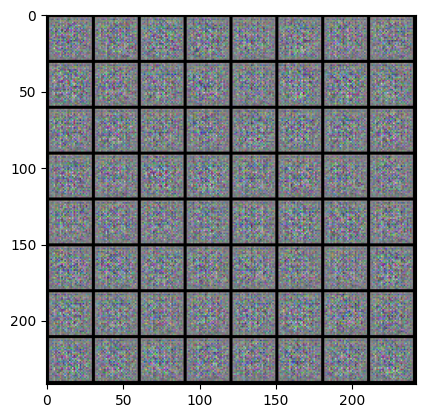

500it [04:50,  1.75it/s, Epoch=1/5, Step=501/1583, D_Loss=0.5659, G_Loss=3.9464, D(x)=0.9308, D(G(z))=0.3171/0.0305]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


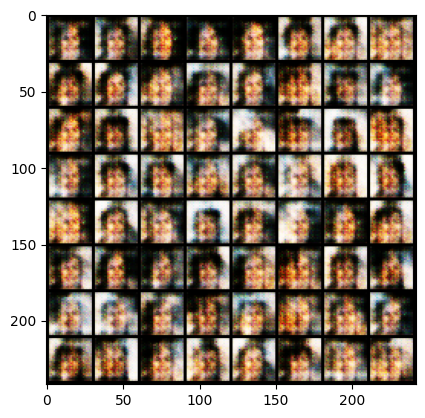

1000it [09:38,  1.76it/s, Epoch=1/5, Step=1001/1583, D_Loss=0.4601, G_Loss=1.9998, D(x)=0.7948, D(G(z))=0.1803/0.1603]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


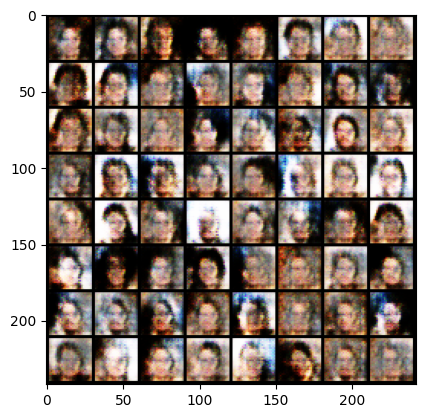

1500it [14:26,  1.73it/s, Epoch=1/5, Step=1501/1583, D_Loss=0.8713, G_Loss=0.9697, D(x)=0.5160, D(G(z))=0.1108/0.4256]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


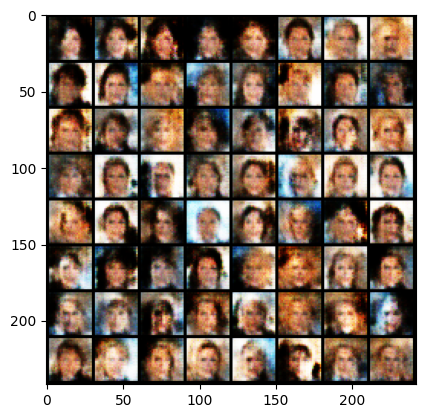

1583it [15:15,  1.73it/s, Epoch=1/5, Step=1551/1583, D_Loss=1.3828, G_Loss=2.4206, D(x)=0.9364, D(G(z))=0.6936/0.1546]


FID: 106.28223419189453	IS: [1.0010690689086914, 0.0019115209579467773]


417it [03:57,  1.77it/s, Epoch=2/5, Step=401/1583, D_Loss=0.4943, G_Loss=1.3340, D(x)=0.7648, D(G(z))=0.1530/0.2907]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


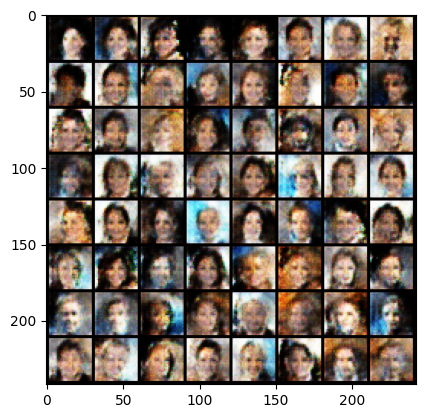

917it [08:42,  1.70it/s, Epoch=2/5, Step=901/1583, D_Loss=1.4538, G_Loss=1.9351, D(x)=0.5615, D(G(z))=0.5426/0.1963]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


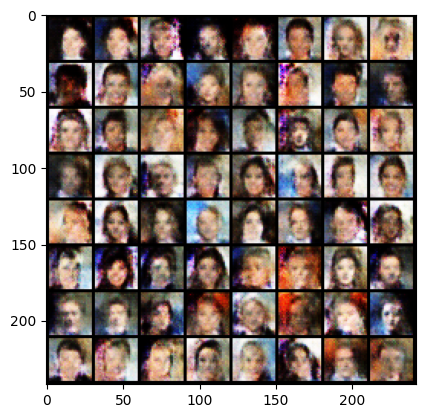

1417it [13:27,  1.77it/s, Epoch=2/5, Step=1401/1583, D_Loss=1.7857, G_Loss=1.4321, D(x)=0.8892, D(G(z))=0.7966/0.3377]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


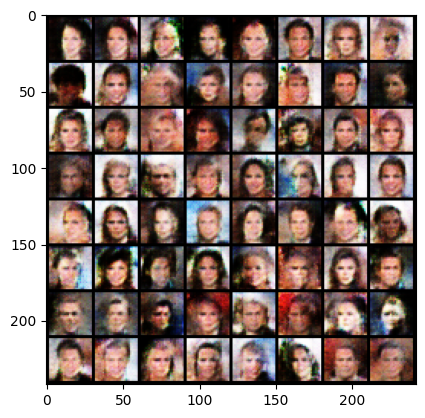

1583it [15:03,  1.75it/s, Epoch=2/5, Step=1551/1583, D_Loss=0.3938, G_Loss=1.1099, D(x)=0.8536, D(G(z))=0.1993/0.3446]


FID: 106.69456481933594	IS: [1.000905990600586, 0.0020957470405846834]


334it [03:09,  1.77it/s, Epoch=3/5, Step=301/1583, D_Loss=0.9539, G_Loss=1.5727, D(x)=0.6524, D(G(z))=0.3694/0.2353]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


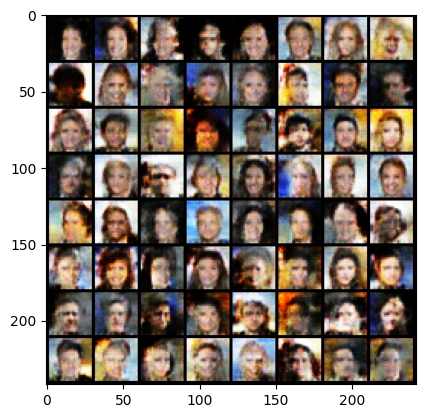

834it [07:54,  1.77it/s, Epoch=3/5, Step=801/1583, D_Loss=0.7234, G_Loss=1.3764, D(x)=0.7678, D(G(z))=0.2997/0.2804]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


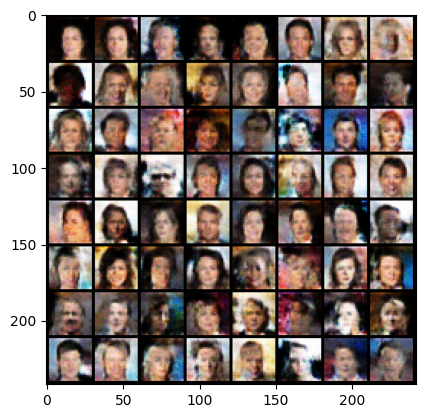

1334it [12:39,  1.78it/s, Epoch=3/5, Step=1301/1583, D_Loss=0.8825, G_Loss=1.5047, D(x)=0.7679, D(G(z))=0.4119/0.2320]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


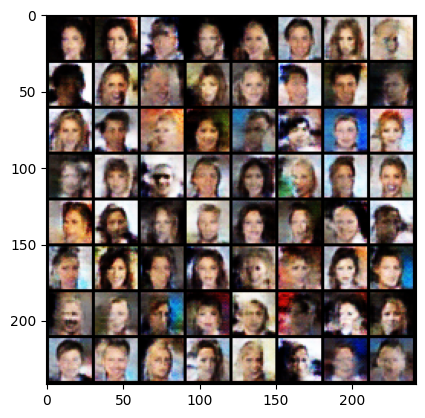

1583it [15:01,  1.76it/s, Epoch=3/5, Step=1551/1583, D_Loss=0.5758, G_Loss=0.8052, D(x)=0.8837, D(G(z))=0.3396/0.4675]


FID: 107.02774810791016	IS: [1.0007952451705933, 0.0014225096674636006]


251it [02:22,  1.78it/s, Epoch=4/5, Step=251/1583, D_Loss=2.2833, G_Loss=1.9603, D(x)=0.9253, D(G(z))=0.8637/0.2453]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


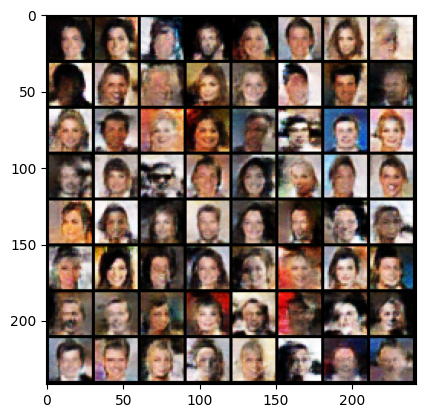

751it [07:06,  1.77it/s, Epoch=4/5, Step=751/1583, D_Loss=0.2931, G_Loss=1.0751, D(x)=0.8302, D(G(z))=0.0973/0.3666]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


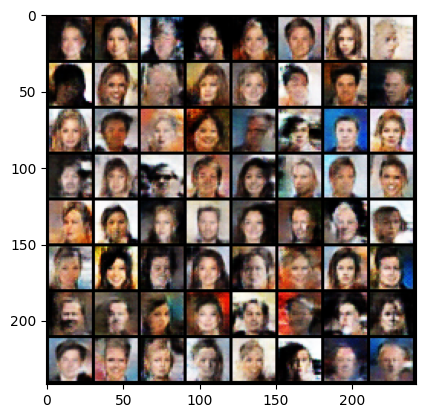

1251it [11:49,  1.76it/s, Epoch=4/5, Step=1251/1583, D_Loss=0.9200, G_Loss=1.6049, D(x)=0.6166, D(G(z))=0.3211/0.2361]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


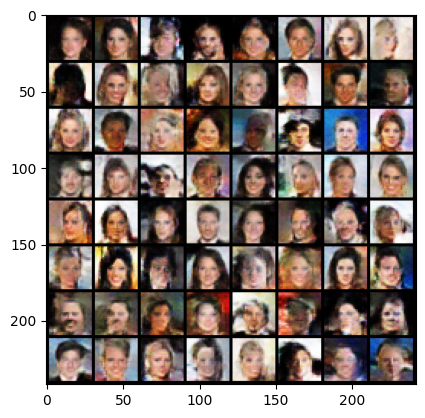

1583it [14:58,  1.76it/s, Epoch=4/5, Step=1551/1583, D_Loss=2.0192, G_Loss=1.0328, D(x)=0.7387, D(G(z))=0.7750/0.4544]


FID: 107.30428314208984	IS: [1.0007084608078003, 0.0010401548352092505]


168it [01:36,  1.72it/s, Epoch=5/5, Step=151/1583, D_Loss=0.9406, G_Loss=1.3632, D(x)=0.8330, D(G(z))=0.5128/0.2995]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


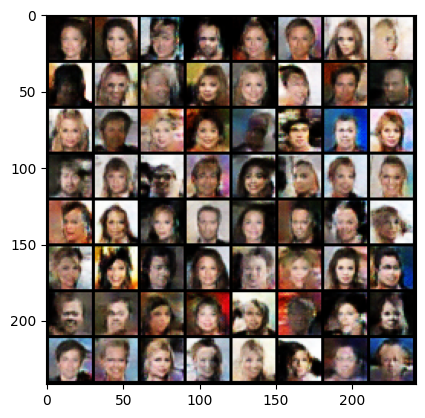

668it [06:23,  1.69it/s, Epoch=5/5, Step=651/1583, D_Loss=1.2770, G_Loss=2.1000, D(x)=0.7148, D(G(z))=0.5420/0.1499]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


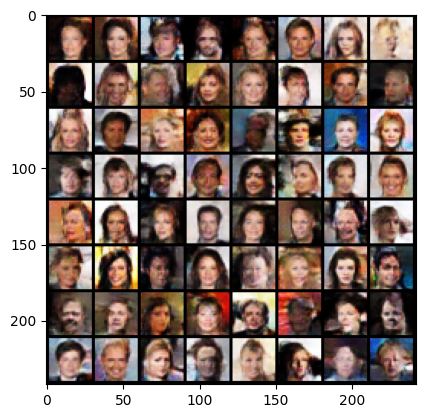

1168it [11:10,  1.77it/s, Epoch=5/5, Step=1151/1583, D_Loss=0.4318, G_Loss=2.0240, D(x)=0.9072, D(G(z))=0.2506/0.1407]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


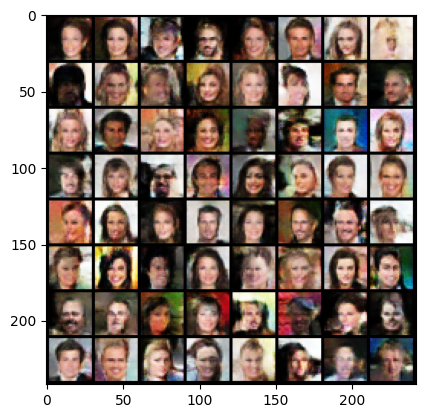

1582it [15:07,  1.79it/s, Epoch=5/5, Step=1551/1583, D_Loss=1.1236, G_Loss=0.7300, D(x)=0.6322, D(G(z))=0.4493/0.4963]

tensor([0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0,
        1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1,
        1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1])


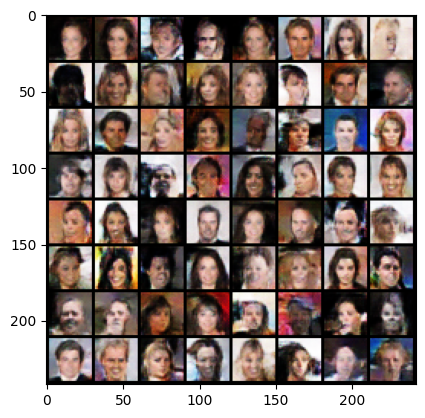

1583it [15:10,  1.74it/s, Epoch=5/5, Step=1551/1583, D_Loss=1.1236, G_Loss=0.7300, D(x)=0.6322, D(G(z))=0.4493/0.4963]


FID: 107.60912322998047	IS: [1.0006183385849, 0.0009072624379768968]


In [244]:
print("Starting Training Loop...")
for epoch in range(num_epochs):
    cur_tqdm = tqdm(enumerate(dataloader, 0))
    for i, data in cur_tqdm:        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        errD, D_x, D_G_z1 = train_cond_discriminator(netCD, netCG, data)

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        errG, D_G_z2 = train_cond_generator(netCG, netCD, data)
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        real_scores.append(D_x)
        fake_scores.append(D_G_z1)
        

        if i % 50 == 0:
            show_dict = {'Epoch': f'{epoch + 1}/{num_epochs}',
                         'Step': f'{i + 1}/{len(dataloader)}',
                         'D_Loss': f'{errD.item():.4f}',
                         'G_Loss': f'{errG.item():.4f}',
                         'D(x)': f'{D_x:.4f}',
                         'D(G(z))': f'{D_G_z1:.4f}/{D_G_z2:.4f}'}
            
            cur_tqdm.set_postfix(show_dict)

        if (iters % 500 == 0) or ((epoch == num_epochs - 1) and (i == len(dataloader) - 1)):
            
            gen_labels = torch.randint(0, n_classes, (b_size,))

            with torch.no_grad():
                generated_images = netCG(noise, onehot[gen_labels]).to(torch.uint8)
                
            fid_metric.update(real_cpu.to(torch.uint8), real=True)
            fid_metric.update(generated_images, real=False)
            inception_metric.update(generated_images)
            
            with torch.no_grad():
                fake = netCG(fixed_noise, onehot[fixed_labels]).detach().cpu()

            fake_grid = vutils.make_grid(fake, padding=2, normalize=True)
            
            print(fixed_labels)
            plt.imshow(np.transpose(fake_grid, (1, 2, 0)))
            plt.show()
            
            img_list.append(fake_grid)

        iters += 1
    
    fid_val = fid_metric.compute()
    inc_val = inception_metric.compute()

    FIDs.append(fid_val.item())
    ISs.append([inc_val[0].item(), inc_val[1].item()])

    print(f"FID: {FIDs[-1]}\tIS: {ISs[-1]}")

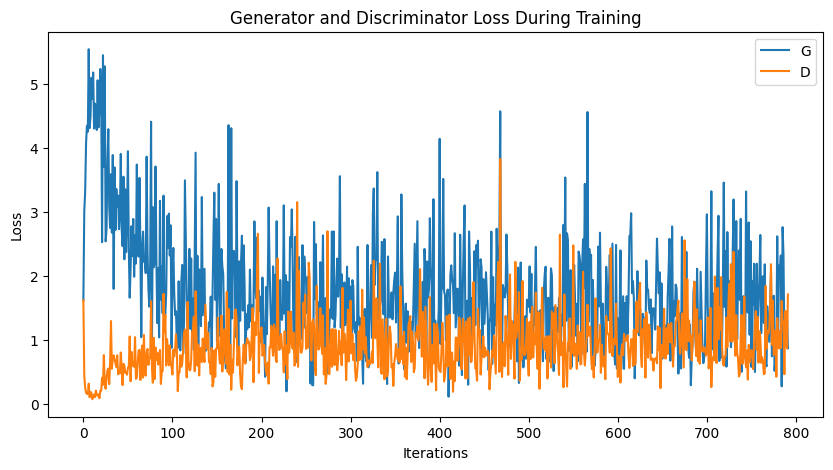

In [248]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses[::10], label="G")
plt.plot(D_losses[::10], label="D")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

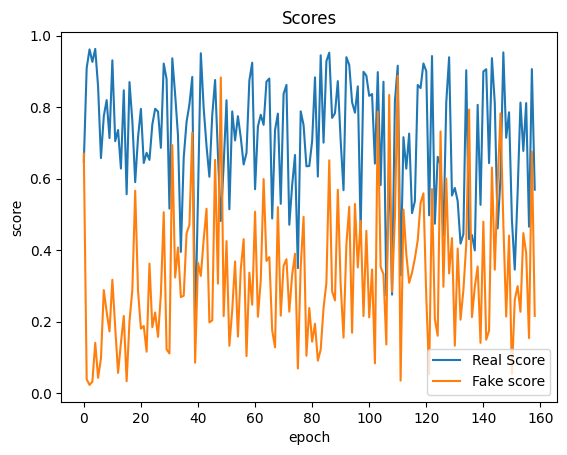

In [252]:
plt.plot(real_scores[::50], "-")
plt.plot(fake_scores[::50], "-")
plt.xlabel("epoch")
plt.ylabel("score")
plt.legend(["Real Score", "Fake score"])
plt.title("Scores");

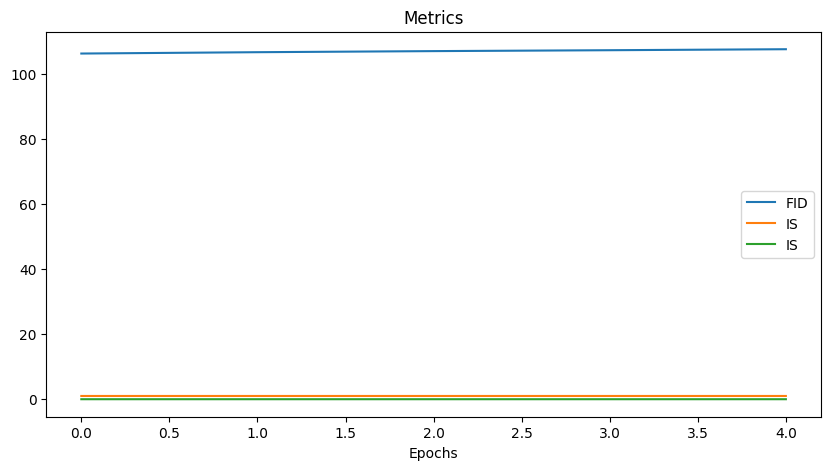

In [253]:
plt.figure(figsize=(10,5))
plt.title("Metrics")
plt.plot(FIDs, label="FID")
plt.plot(ISs, label="IS")
plt.xlabel("Epochs")
plt.legend()
plt.show()

gen_labels=tensor([0, 0, 0, 1, 1, 0, 1, 1, 1, 1])


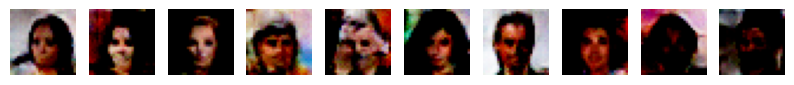

In [271]:
def generate_samples():
    num_samples = 10
    noise = torch.randn(num_samples, nz, device=device)
    gen_labels = torch.randint(0, n_classes, (num_samples,))
    print(f"{gen_labels=}")
    
    samples = netCG(noise, onehot[gen_labels])
    
    fig, axes = plt.subplots(1, num_samples, figsize=(10, 2))
    for i, ax in enumerate(axes):
        ax.imshow(samples[i].view(img_shape).cpu().detach().numpy().transpose((1, 2, 0)))
        ax.axis('off')
    plt.show()


generate_samples()

In [262]:
torch.save({
            'epoch': epoch,
            'model_state_dict': netCG.state_dict(),
            'optimizer_state_dict': optimizerCG.state_dict(),
            }, 'cdcgan-g-1.pth')

In [263]:
torch.save({
            'epoch': epoch,
            'model_state_dict': netCD.state_dict(),
            'optimizer_state_dict': optimizerCD.state_dict(),
            }, 'cdcgan-d-1.pth')

In [ ]:
# model = TheModelClass(*args, **kwargs)
# optimizer = TheOptimizerClass(*args, **kwargs)

checkpoint = torch.load(PATH, weights_only=True)
model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']

model.eval()
# - or -
model.train()